<a href="https://colab.research.google.com/github/lbhargav/Convolutional-Neural-Networks/blob/master/Sketchy_DC_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Image Generation from Sketch Images**

In [0]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Importing libraries

In [0]:
import time
import os
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import math
import datetime

from keras.models import Sequential
from keras.models import load_model
from keras.layers import Conv2D, Conv2DTranspose, Reshape
from keras.layers import Flatten, BatchNormalization, Dense, Activation
from keras.layers.advanced_activations import LeakyReLU
from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator


Using TensorFlow backend.


Loading Dataset

In [0]:
def load_dataset(dataset_path, batch_size, image_shape):
    dataset_generator = ImageDataGenerator()
    dataset_generator = dataset_generator.flow_from_directory(
        dataset_path, target_size=(image_shape[0], image_shape[1]),
        batch_size=batch_size,
        class_mode=None)

    return dataset_generator

In [0]:
# Creates the discriminator model
def construct_discriminator(image_shape):

    discriminator = Sequential()
    
    discriminator.add(Conv2D(filters=16, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform',
                             input_shape=(image_shape), name="discriminator_-1"))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(filters=32, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform',name="discriminator_0"))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(filters=64, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform',name="discriminator_1"))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Conv2D(filters=128, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="discriminator_2"))
    discriminator.add(BatchNormalization(momentum=0.5))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Conv2D(filters=256, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="discriminator_3"))
    discriminator.add(BatchNormalization(momentum=0.5))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Conv2D(filters=512, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="discriminator_4"))
    discriminator.add(BatchNormalization(momentum=0.5))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Flatten())
    discriminator.add(Dense(1))
    discriminator.add(Activation('sigmoid'))

    optimizer = Adam(lr=0.0002, beta_1=0.5)
    discriminator.compile(loss='binary_crossentropy',
                          optimizer=optimizer,
                          metrics=None)

    return discriminator

In [0]:
# Creates the generator model.
def construct_generator(image_shape):

    generator = Sequential()
    
    generator.add(Conv2D(filters=4, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform',
                             input_shape=(image_shape), name="generator_-2"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Conv2D(filters=8, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="generator_-1"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Conv2D(filters=16, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="generator_0"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Conv2D(filters=32, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="generator_1"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(LeakyReLU(0.2))

    generator.add(Conv2D(filters=64, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="generator_2"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(LeakyReLU(0.2))

    generator.add(Conv2D(filters=128, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_uniform', name="generator_3"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Conv2DTranspose(filters=256, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_uniform', name="generator_4"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))

    generator.add(Conv2DTranspose(filters=128, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_uniform', name="generator_5"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))

    generator.add(Conv2DTranspose(filters=64, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_uniform', name="generator_6"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))
    
    generator.add(Conv2DTranspose(filters=32, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_uniform', name="generator_7"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))
    
    generator.add(Conv2DTranspose(filters=16, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_uniform', name="generator_8"))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))

    generator.add(Conv2DTranspose(filters=3, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_uniform', name="generator_9"))
    generator.add(Activation('tanh'))

    optimizer = Adam(lr=0.00015, beta_1=0.5)
    generator.compile(loss='binary_crossentropy',
                      optimizer=optimizer,
                      metrics=None)

    return generator

In [0]:
# Displays a figure of the generated images and saves them in as .png image
def save_generated_images(generated_images, epoch, batch_number, batch_size=64, file_name='generatedSamples_epoch'):
    
    grids = math.ceil(math.sqrt(batch_size))
    plt.figure(figsize=(grids, grids), num=2)
    gs1 = gridspec.GridSpec(grids, grids)
    gs1.update(wspace=0, hspace=0)

    for i in range(batch_size):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        image = generated_images[i, :, :, :]
        image += 1
        image *= 127.5
        fig = plt.imshow(image.astype(np.uint8))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)

    plt.tight_layout()
    save_name = 'drive/My Drive/render/GAN/generated images/'+file_name + str(
        epoch + 1) + '_batch' + str(batch_number + 1) + '.png'

    plt.savefig(save_name, bbox_inches='tight', pad_inches=0)
    plt.pause(0.0000000001)
    plt.show()

In [0]:
# load a saved model
def load_old_model(epoch, folder_name):
    gan = Sequential()
    discriminator = load_model('drive/My Drive/render/GAN/models/'+folder_name+'/discriminator_epoch' +
                               str(epoch) + '.hdf5')
    discriminator.trainable = False
    
    generator = load_model('drive/My Drive/render/GAN/models/'+folder_name+'/generator_epoch' +
                               str(epoch) + '.hdf5')
    
    gan.add(generator)
    gan.add(discriminator)
    return gan, discriminator, generator

In [0]:
# creates a new model
def create_new_model(image_shape):
    generator = construct_generator(image_shape)
    discriminator = construct_discriminator(image_shape)

    gan = Sequential()
    # Only false for the adversarial model
    discriminator.trainable = False
    gan.add(generator)
    gan.add(discriminator)
    return gan, discriminator, generator

**Training**

In [0]:
def train_dcgan(batch_size, epochs, image_shape, dataset_path, sketch_path, retrain, model_folder, saved_epoch):
    if retrain:
        gan, discriminator, generator = load_old_model(saved_epoch, model_folder)
    else:
        gan, discriminator, generator = create_new_model(image_shape)

    optimizer = Adam(lr=0.00015, beta_1=0.5)
    gan.compile(loss='binary_crossentropy', optimizer=optimizer,
                metrics=None)

    # Create a dataset Generator with help of keras
    dataset_real = load_dataset(dataset_path, batch_size, image_shape)
    dataset_sketch = load_dataset(sketch_path, batch_size, image_shape)

    number_of_batches = int(10000 / batch_size)

    # Variables that will be used to plot the losses from the discriminator and
    # the adversarial models
    adversarial_loss = np.empty(shape=1)
    discriminator_loss = np.empty(shape=1)
    batches = np.empty(shape=1)

    # Allo plot updates inside for loop
    plt.ion()

    current_batch = 0
    
    folder_name = datetime.datetime.now().strftime("%Y-%m-%d")

    # Let's train the DCGAN for n epochs
    for epoch in range(epochs):

        print("Epoch " + str(epoch+1) + "/" + str(epochs) + " :")

        for batch_number in range(number_of_batches):

            start_time = time.time()

            # Get the current batch and normalize the images between -1 and 1
            real_images = dataset_real.next()
            real_images /= 127.5
            real_images -= 1

            current_batch_size = real_images.shape[0]
            sketch = dataset_sketch.next()
            sketch /= 127.5
            sketch -= 1
            

            # Generate images
            generated_images = generator.predict(sketch)
            real_y = (np.ones(current_batch_size) -
                      np.random.random_sample(current_batch_size) * 0.2)
            fake_y = np.random.random_sample(current_batch_size) * 0.2

            # Let's train the discriminator
            discriminator.trainable = True

            d_loss = discriminator.train_on_batch(real_images, real_y)
            d_loss += discriminator.train_on_batch(generated_images, fake_y)

            discriminator_loss = np.append(discriminator_loss, d_loss)

            # Now it's time to train the generator
            discriminator.trainable = False
            fake_y = (np.ones(current_batch_size) -
                      np.random.random_sample(current_batch_size) * 0.2)

            g_loss = gan.train_on_batch(sketch, fake_y)
            adversarial_loss = np.append(adversarial_loss, g_loss)
            batches = np.append(batches, current_batch)

            # Each 50 batches show and save images
            if((batch_number + 1) % 50 == 0 and
               current_batch_size == batch_size):
                save_generated_images(generated_images, epoch, batch_number)

            time_elapsed = time.time() - start_time

            # Display and plot the results
            print("     Batch " + str(batch_number + 1) + "/" +
                  str(number_of_batches) +
                  " generator loss | discriminator loss : " +
                  str(g_loss) + " | " + str(d_loss) + ' - batch took ' +
                  str(time_elapsed) + ' s.')

            current_batch += 1

        # Save the model weights each 5 epochs
        if (epoch+1)%5 == 0:
            if not os.path.exists('drive/My Drive/render/GAN/models/'+folder_name):
                os.makedirs('drive/My Drive/render/GAN/models/'+folder_name)
            discriminator.trainable = True
            generator.save('drive/My Drive/render/GAN/models/'+folder_name+'/generator_epoch' + str(epoch) + '.hdf5', True, True)
            discriminator.save('drive/My Drive/render/GAN/models/'+folder_name+'/discriminator_epoch' +
                               str(epoch) + '.hdf5', True, True)
    return folder_name

In [0]:

# Displays a figure of the generated images and saves them in as .png image
def save_generated_test_images(generated_images, folder_name, batch_size=64, file_name='generatedSamples_epoch'):
    
    if not os.path.exists('generated test images/'+folder_name+'/'):
        os.makedirs('generated test images/'+folder_name+'/')
        
    for i in range(batch_size):
        image = generated_images[i, :, :, :]
        image += 1
        image *= 127.5
        fig = plt.imshow(image.astype(np.uint8))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    
        save_name = 'generated test images/'+folder_name+'/'+file_name + '_' + str(i) + '.png'

        plt.savefig(save_name, bbox_inches='tight', pad_inches=0)
        plt.pause(0.0000000001)

In [0]:
def test_model(test_path, number_img, image_shape, saved_epoch, model_name, file_extd_name=''):
    
    print("Reading Data-----")
    batch_size = number_img
    test_dataset = load_dataset(test_path, batch_size, image_shape)
    
    image = test_dataset.next()
    image /= 127.5
    image -= 1

    print("Reading Model-----")
    gan, discriminator, generator = load_old_model(saved_epoch, model_name)

    print("Generating Images-----")
    generated_image = generator.predict(image)
    
    print("Saving Images-----")
    save_generated_test_images(image, folder_name=model_name+'/sketches', batch_size=batch_size, file_name='sketch_test'+file_extd_name)
    save_generated_test_images(generated_image, folder_name=model_name+'/images', batch_size=batch_size, file_name='generated_test'+file_extd_name)
    print("Completed")

Found 400 images belonging to 1 classes.
Found 400 images belonging to 1 classes.
Epoch 1/60 :
     Batch 1/184 generator loss | discriminator loss : 2.2407598 | 0.6858852 - batch took 85.05509996414185 s.
     Batch 2/184 generator loss | discriminator loss : 1.915067 | 0.6851357 - batch took 63.1944854259491 s.
     Batch 3/184 generator loss | discriminator loss : 1.6267134 | 0.6621135 - batch took 66.42010378837585 s.
     Batch 4/184 generator loss | discriminator loss : 2.803574 | 0.7490097 - batch took 61.264424562454224 s.
     Batch 5/184 generator loss | discriminator loss : 2.5535185 | 0.68982625 - batch took 60.14554405212402 s.
     Batch 6/184 generator loss | discriminator loss : 2.3946304 | 0.6555931 - batch took 55.91275429725647 s.
     Batch 7/184 generator loss | discriminator loss : 3.0187407 | 0.77286494 - batch took 15.933060884475708 s.
     Batch 8/184 generator loss | discriminator loss : 2.7043197 | 0.7057346 - batch took 1.4246225357055664 s.
     Batch 9/18

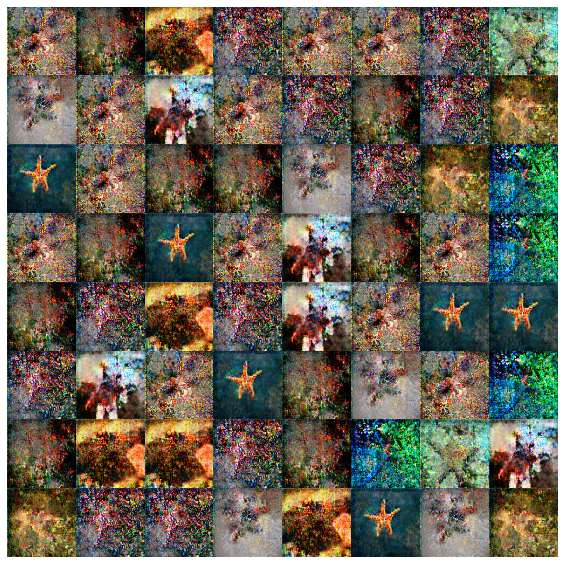

     Batch 50/184 generator loss | discriminator loss : 2.3695614 | 0.6702652 - batch took 5.798936367034912 s.
     Batch 51/184 generator loss | discriminator loss : 2.5807438 | 0.7043427 - batch took 1.6855359077453613 s.
     Batch 52/184 generator loss | discriminator loss : 2.319827 | 0.6809805 - batch took 1.358726978302002 s.
     Batch 53/184 generator loss | discriminator loss : 2.1583807 | 0.63538814 - batch took 1.344196081161499 s.
     Batch 54/184 generator loss | discriminator loss : 2.3114247 | 0.67988014 - batch took 1.3386197090148926 s.
     Batch 55/184 generator loss | discriminator loss : 2.264762 | 0.6951575 - batch took 1.335639476776123 s.
     Batch 56/184 generator loss | discriminator loss : 3.0811603 | 0.6743772 - batch took 0.371401309967041 s.
     Batch 57/184 generator loss | discriminator loss : 2.291289 | 0.6765922 - batch took 1.3289525508880615 s.
     Batch 58/184 generator loss | discriminator loss : 2.9421065 | 0.67553234 - batch took 1.34529638

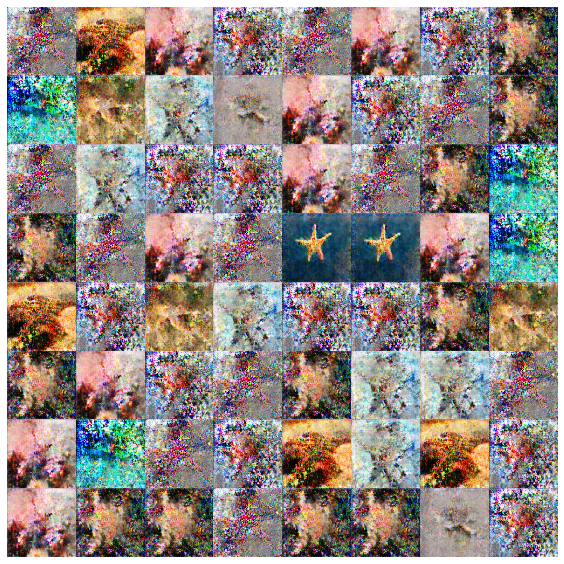

     Batch 100/184 generator loss | discriminator loss : 1.7154933 | 0.7224493 - batch took 5.944531202316284 s.
     Batch 101/184 generator loss | discriminator loss : 4.5365963 | 0.7974824 - batch took 1.6955344676971436 s.
     Batch 102/184 generator loss | discriminator loss : 2.9890852 | 1.166688 - batch took 1.3387048244476318 s.
     Batch 103/184 generator loss | discriminator loss : 2.3625748 | 0.88513297 - batch took 1.345881700515747 s.
     Batch 104/184 generator loss | discriminator loss : 2.4225373 | 0.8158519 - batch took 1.3323264122009277 s.
     Batch 105/184 generator loss | discriminator loss : 2.4785175 | 0.6864158 - batch took 0.37055277824401855 s.
     Batch 106/184 generator loss | discriminator loss : 3.3919458 | 0.85920006 - batch took 1.3412256240844727 s.
     Batch 107/184 generator loss | discriminator loss : 2.2258158 | 0.8264115 - batch took 1.32200288772583 s.
     Batch 108/184 generator loss | discriminator loss : 2.1030247 | 0.7584683 - batch too

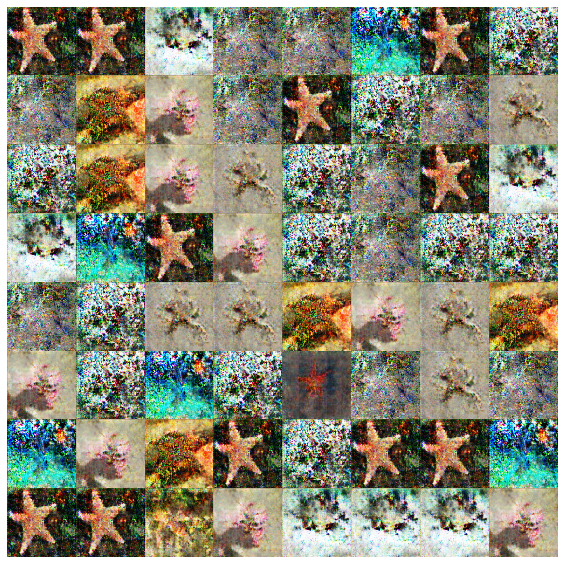

     Batch 150/184 generator loss | discriminator loss : 2.1864243 | 0.6906665 - batch took 5.811702489852905 s.
     Batch 151/184 generator loss | discriminator loss : 2.2896495 | 0.6469207 - batch took 1.6946918964385986 s.
     Batch 152/184 generator loss | discriminator loss : 2.1424398 | 0.65676403 - batch took 1.3485641479492188 s.
     Batch 153/184 generator loss | discriminator loss : 2.461955 | 0.68521416 - batch took 1.3660423755645752 s.
     Batch 154/184 generator loss | discriminator loss : 2.82474 | 0.8591361 - batch took 0.3917849063873291 s.
     Batch 155/184 generator loss | discriminator loss : 2.8905962 | 0.74559355 - batch took 1.3431293964385986 s.
     Batch 156/184 generator loss | discriminator loss : 2.3841722 | 0.70920825 - batch took 1.3506464958190918 s.
     Batch 157/184 generator loss | discriminator loss : 1.9807522 | 0.6248776 - batch took 1.340817928314209 s.
     Batch 158/184 generator loss | discriminator loss : 3.455133 | 0.6476488 - batch too

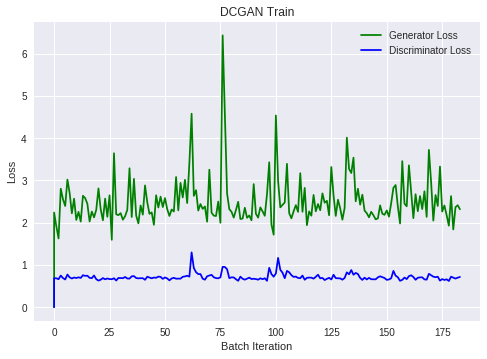

Epoch 2/60 :
     Batch 1/184 generator loss | discriminator loss : 2.8779254 | 0.68671525 - batch took 1.3507435321807861 s.
     Batch 2/184 generator loss | discriminator loss : 2.1648736 | 0.687093 - batch took 1.3278629779815674 s.
     Batch 3/184 generator loss | discriminator loss : 2.1452758 | 0.6876344 - batch took 1.3528931140899658 s.
     Batch 4/184 generator loss | discriminator loss : 2.8862138 | 0.6764658 - batch took 1.3589015007019043 s.
     Batch 5/184 generator loss | discriminator loss : 4.0710354 | 0.7945316 - batch took 0.38152623176574707 s.
     Batch 6/184 generator loss | discriminator loss : 2.5054014 | 0.74540687 - batch took 1.347869634628296 s.
     Batch 7/184 generator loss | discriminator loss : 2.2489853 | 0.743048 - batch took 1.3493645191192627 s.
     Batch 8/184 generator loss | discriminator loss : 2.429449 | 0.72331333 - batch took 1.3270950317382812 s.
     Batch 9/184 generator loss | discriminator loss : 2.8388321 | 0.6798465 - batch took 1

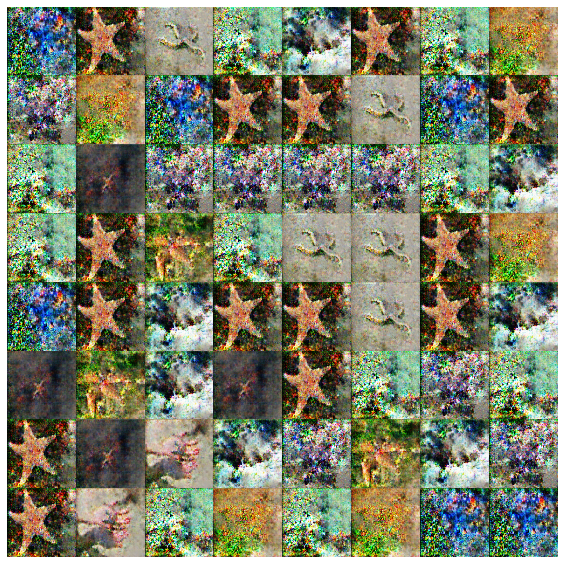

     Batch 50/184 generator loss | discriminator loss : 2.0136757 | 0.74485916 - batch took 6.256514549255371 s.
     Batch 51/184 generator loss | discriminator loss : 2.776276 | 0.7063552 - batch took 1.686033010482788 s.
     Batch 52/184 generator loss | discriminator loss : 2.2119634 | 0.65166605 - batch took 1.34647798538208 s.
     Batch 53/184 generator loss | discriminator loss : 2.1502562 | 0.67085236 - batch took 1.3455314636230469 s.
     Batch 54/184 generator loss | discriminator loss : 2.7785044 | 0.6959531 - batch took 0.37139081954956055 s.
     Batch 55/184 generator loss | discriminator loss : 2.324563 | 0.6532397 - batch took 1.3308382034301758 s.
     Batch 56/184 generator loss | discriminator loss : 2.2673335 | 0.6805198 - batch took 1.3192055225372314 s.
     Batch 57/184 generator loss | discriminator loss : 2.110134 | 0.673108 - batch took 1.3443856239318848 s.
     Batch 58/184 generator loss | discriminator loss : 2.028829 | 0.6630404 - batch took 1.32949209

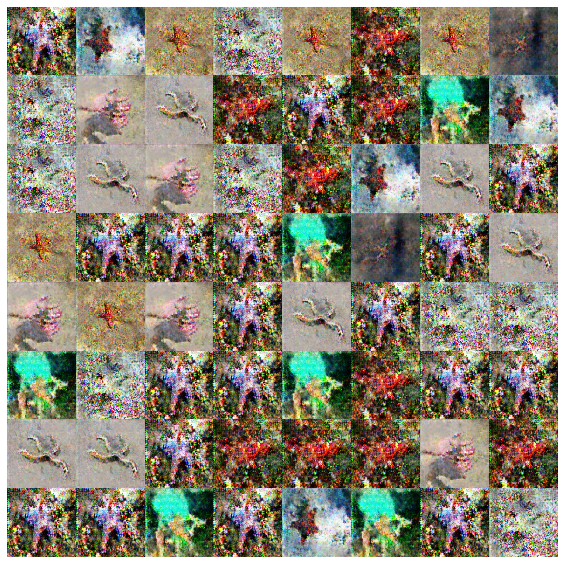

     Batch 100/184 generator loss | discriminator loss : 2.207829 | 0.6757785 - batch took 6.035030126571655 s.
     Batch 101/184 generator loss | discriminator loss : 2.3750615 | 0.6628418 - batch took 1.6820449829101562 s.
     Batch 102/184 generator loss | discriminator loss : 2.2061267 | 0.68904084 - batch took 1.333000898361206 s.
     Batch 103/184 generator loss | discriminator loss : 1.8802938 | 0.67791533 - batch took 0.3774552345275879 s.
     Batch 104/184 generator loss | discriminator loss : 2.9485605 | 0.72894734 - batch took 1.3312304019927979 s.
     Batch 105/184 generator loss | discriminator loss : 2.787676 | 0.7377951 - batch took 1.3362843990325928 s.
     Batch 106/184 generator loss | discriminator loss : 1.7419524 | 0.72313666 - batch took 1.3349525928497314 s.
     Batch 107/184 generator loss | discriminator loss : 2.789218 | 0.6832671 - batch took 1.3299369812011719 s.
     Batch 108/184 generator loss | discriminator loss : 2.2473285 | 0.7178344 - batch to

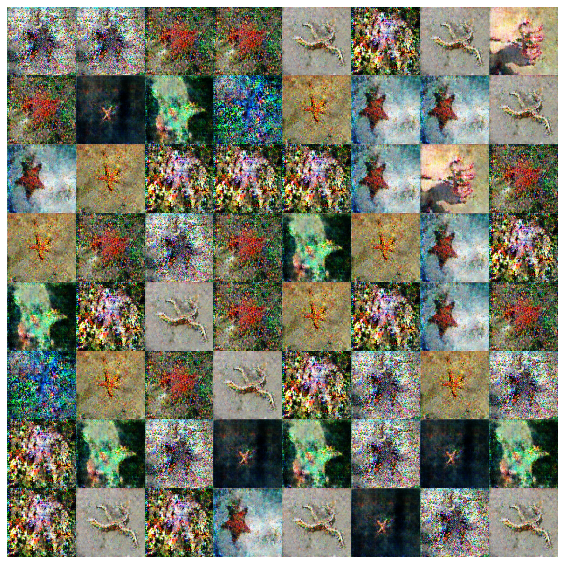

     Batch 150/184 generator loss | discriminator loss : 2.587142 | 0.681247 - batch took 5.686589956283569 s.
     Batch 151/184 generator loss | discriminator loss : 2.0547857 | 0.7246644 - batch took 1.5822713375091553 s.
     Batch 152/184 generator loss | discriminator loss : 3.1289654 | 0.6909384 - batch took 0.3831019401550293 s.
     Batch 153/184 generator loss | discriminator loss : 2.6922765 | 0.735028 - batch took 1.344268560409546 s.
     Batch 154/184 generator loss | discriminator loss : 2.998612 | 0.75044405 - batch took 1.3410608768463135 s.
     Batch 155/184 generator loss | discriminator loss : 2.2504482 | 0.7429129 - batch took 1.3391375541687012 s.
     Batch 156/184 generator loss | discriminator loss : 2.5062852 | 0.7588161 - batch took 1.3378756046295166 s.
     Batch 157/184 generator loss | discriminator loss : 2.0672998 | 0.7893623 - batch took 1.3297455310821533 s.
     Batch 158/184 generator loss | discriminator loss : 2.7109914 | 0.7257365 - batch took 1

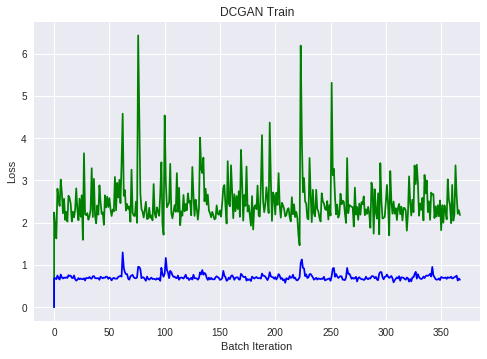

Epoch 3/60 :
     Batch 1/184 generator loss | discriminator loss : 2.4570603 | 0.75006247 - batch took 1.3456175327301025 s.
     Batch 2/184 generator loss | discriminator loss : 2.1472552 | 0.684049 - batch took 1.3281147480010986 s.
     Batch 3/184 generator loss | discriminator loss : 2.2644663 | 0.7202308 - batch took 0.370297908782959 s.
     Batch 4/184 generator loss | discriminator loss : 2.2650466 | 0.6708666 - batch took 1.3322277069091797 s.
     Batch 5/184 generator loss | discriminator loss : 2.5516143 | 0.68926466 - batch took 1.335378885269165 s.
     Batch 6/184 generator loss | discriminator loss : 2.4117098 | 0.6683579 - batch took 1.3246076107025146 s.
     Batch 7/184 generator loss | discriminator loss : 2.017501 | 0.7087401 - batch took 1.3322679996490479 s.
     Batch 8/184 generator loss | discriminator loss : 2.4062014 | 0.6725698 - batch took 1.3296072483062744 s.
     Batch 9/184 generator loss | discriminator loss : 2.111891 | 0.6982985 - batch took 1.31

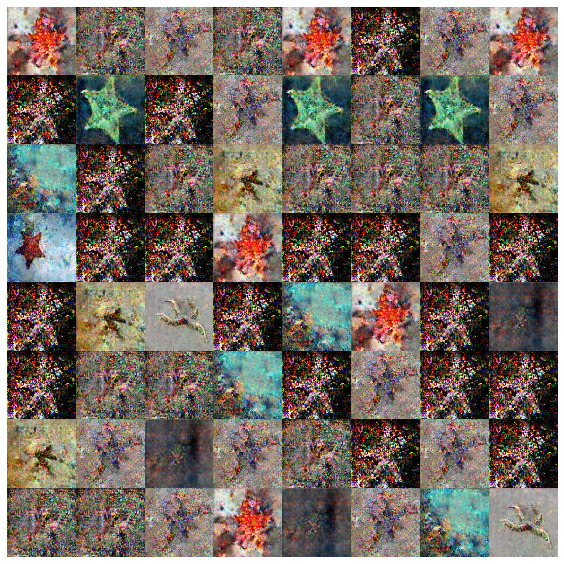

     Batch 50/184 generator loss | discriminator loss : 2.6101198 | 0.6665756 - batch took 6.122929096221924 s.
     Batch 51/184 generator loss | discriminator loss : 2.5064325 | 0.6972203 - batch took 1.684513807296753 s.
     Batch 52/184 generator loss | discriminator loss : 2.470214 | 0.7409612 - batch took 0.3795599937438965 s.
     Batch 53/184 generator loss | discriminator loss : 2.1803064 | 0.6857978 - batch took 1.366262674331665 s.
     Batch 54/184 generator loss | discriminator loss : 2.1467786 | 0.6308552 - batch took 1.3407788276672363 s.
     Batch 55/184 generator loss | discriminator loss : 2.3412268 | 0.63796437 - batch took 1.3321044445037842 s.
     Batch 56/184 generator loss | discriminator loss : 1.920999 | 0.6703226 - batch took 1.3304047584533691 s.
     Batch 57/184 generator loss | discriminator loss : 2.1826613 | 0.65898323 - batch took 1.3194029331207275 s.
     Batch 58/184 generator loss | discriminator loss : 2.3295386 | 0.7050768 - batch took 1.352376

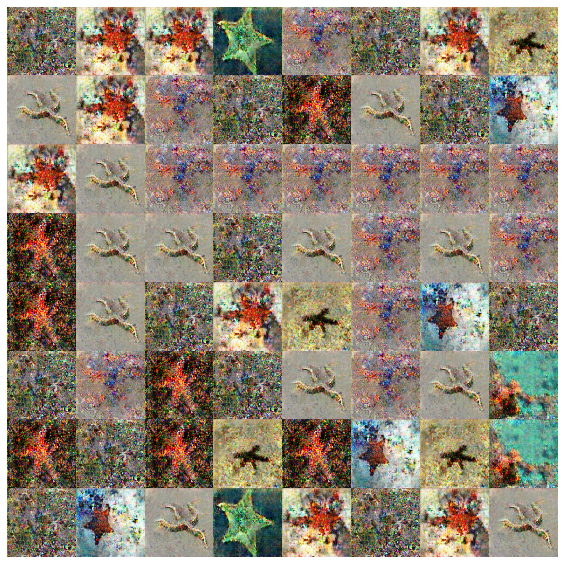

     Batch 100/184 generator loss | discriminator loss : 2.3028193 | 0.6879927 - batch took 5.7467358112335205 s.
     Batch 101/184 generator loss | discriminator loss : 2.2435431 | 0.68006897 - batch took 0.5942468643188477 s.
     Batch 102/184 generator loss | discriminator loss : 2.0434093 | 0.66330326 - batch took 1.3998873233795166 s.
     Batch 103/184 generator loss | discriminator loss : 2.6345522 | 0.6809645 - batch took 1.3487889766693115 s.
     Batch 104/184 generator loss | discriminator loss : 2.622408 | 0.7033843 - batch took 1.3355779647827148 s.
     Batch 105/184 generator loss | discriminator loss : 2.6870956 | 0.67420226 - batch took 1.335062026977539 s.
     Batch 106/184 generator loss | discriminator loss : 2.4889123 | 0.68345916 - batch took 1.3311033248901367 s.
     Batch 107/184 generator loss | discriminator loss : 2.4791517 | 0.65463614 - batch took 1.3270137310028076 s.
     Batch 108/184 generator loss | discriminator loss : 3.4401155 | 0.72776294 - bat

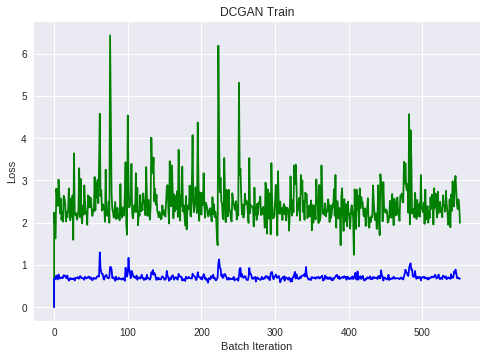

Epoch 4/60 :
     Batch 1/184 generator loss | discriminator loss : 2.6803122 | 0.645851 - batch took 0.375011682510376 s.
     Batch 2/184 generator loss | discriminator loss : 2.5045042 | 0.6457544 - batch took 1.3359758853912354 s.
     Batch 3/184 generator loss | discriminator loss : 1.9267728 | 0.71045995 - batch took 1.3196296691894531 s.
     Batch 4/184 generator loss | discriminator loss : 2.6829638 | 0.6770439 - batch took 1.3280174732208252 s.
     Batch 5/184 generator loss | discriminator loss : 2.2748199 | 0.68011117 - batch took 1.338268756866455 s.
     Batch 6/184 generator loss | discriminator loss : 2.1380155 | 0.6657343 - batch took 1.3336985111236572 s.
     Batch 7/184 generator loss | discriminator loss : 2.3448849 | 0.6439936 - batch took 1.3202154636383057 s.
     Batch 8/184 generator loss | discriminator loss : 2.0407407 | 0.7618047 - batch took 0.3757750988006592 s.
     Batch 9/184 generator loss | discriminator loss : 3.3734603 | 0.8993064 - batch took 1.

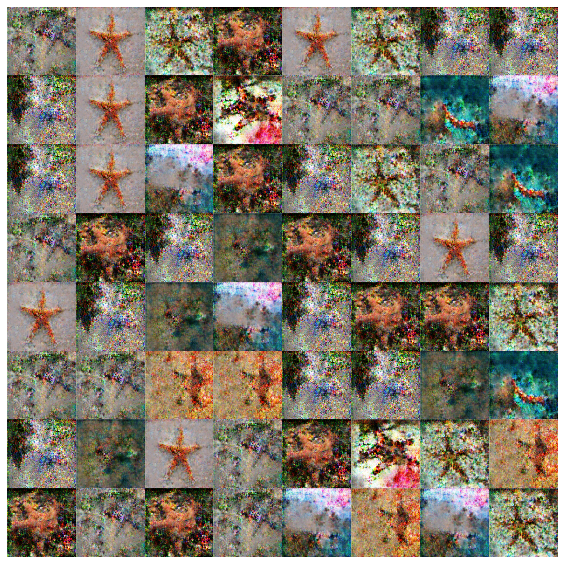

     Batch 100/184 generator loss | discriminator loss : 3.6788652 | 0.82497877 - batch took 6.053250551223755 s.
     Batch 101/184 generator loss | discriminator loss : 2.46968 | 0.8025839 - batch took 1.6795427799224854 s.
     Batch 102/184 generator loss | discriminator loss : 2.715189 | 0.7474844 - batch took 1.352781057357788 s.
     Batch 103/184 generator loss | discriminator loss : 2.2981117 | 0.7364309 - batch took 1.340388298034668 s.
     Batch 104/184 generator loss | discriminator loss : 2.0842597 | 0.7128603 - batch took 1.3296968936920166 s.
     Batch 105/184 generator loss | discriminator loss : 2.432756 | 0.67193586 - batch took 1.3203880786895752 s.
     Batch 106/184 generator loss | discriminator loss : 3.8704643 | 0.84852093 - batch took 0.3690781593322754 s.
     Batch 107/184 generator loss | discriminator loss : 2.8872294 | 0.73300827 - batch took 1.3239972591400146 s.
     Batch 108/184 generator loss | discriminator loss : 1.975903 | 0.73319364 - batch took

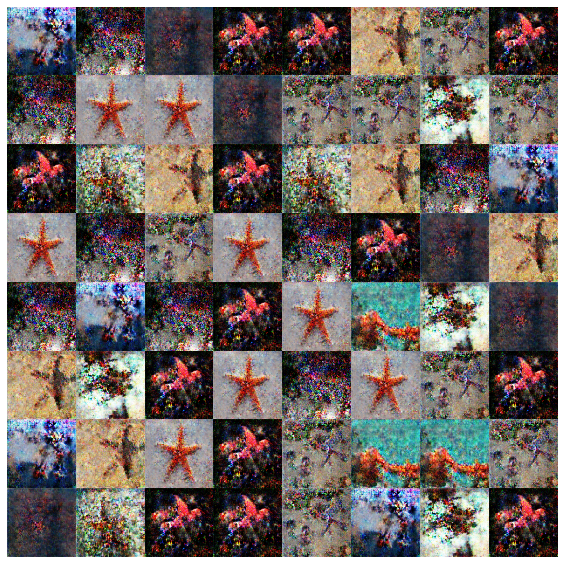

     Batch 150/184 generator loss | discriminator loss : 2.2525399 | 0.6783663 - batch took 5.737013339996338 s.
     Batch 151/184 generator loss | discriminator loss : 2.136035 | 0.664356 - batch took 1.6360111236572266 s.
     Batch 152/184 generator loss | discriminator loss : 2.794427 | 0.71718943 - batch took 1.3401119709014893 s.
     Batch 153/184 generator loss | discriminator loss : 2.395287 | 0.7196008 - batch took 1.3353052139282227 s.
     Batch 154/184 generator loss | discriminator loss : 2.9398282 | 0.6576533 - batch took 1.3329064846038818 s.
     Batch 155/184 generator loss | discriminator loss : 3.9816003 | 0.77526355 - batch took 0.3710157871246338 s.
     Batch 156/184 generator loss | discriminator loss : 2.260903 | 0.709407 - batch took 1.3311550617218018 s.
     Batch 157/184 generator loss | discriminator loss : 2.4182355 | 0.72230756 - batch took 1.348679542541504 s.
     Batch 158/184 generator loss | discriminator loss : 2.0661416 | 0.70211625 - batch took 

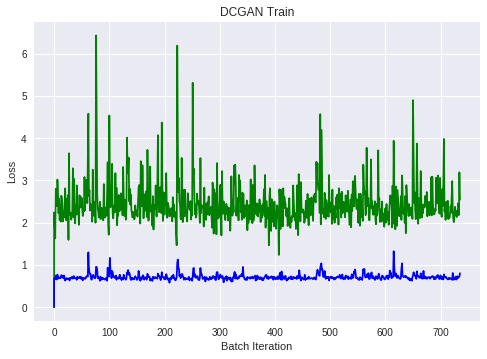

Epoch 5/60 :
     Batch 1/184 generator loss | discriminator loss : 2.5685 | 0.79169565 - batch took 1.3405756950378418 s.
     Batch 2/184 generator loss | discriminator loss : 2.317362 | 0.6709374 - batch took 1.3309919834136963 s.
     Batch 3/184 generator loss | discriminator loss : 2.3646007 | 0.6856288 - batch took 1.3241121768951416 s.
     Batch 4/184 generator loss | discriminator loss : 2.3609579 | 0.7006103 - batch took 1.3298346996307373 s.
     Batch 5/184 generator loss | discriminator loss : 2.040701 | 0.6276798 - batch took 1.3342962265014648 s.
     Batch 6/184 generator loss | discriminator loss : 1.49715 | 0.73671055 - batch took 0.3725855350494385 s.
     Batch 7/184 generator loss | discriminator loss : 3.0960255 | 0.8118136 - batch took 1.3177661895751953 s.
     Batch 8/184 generator loss | discriminator loss : 2.435673 | 0.77332556 - batch took 1.3225319385528564 s.
     Batch 9/184 generator loss | discriminator loss : 1.7315279 | 0.6442156 - batch took 1.3120

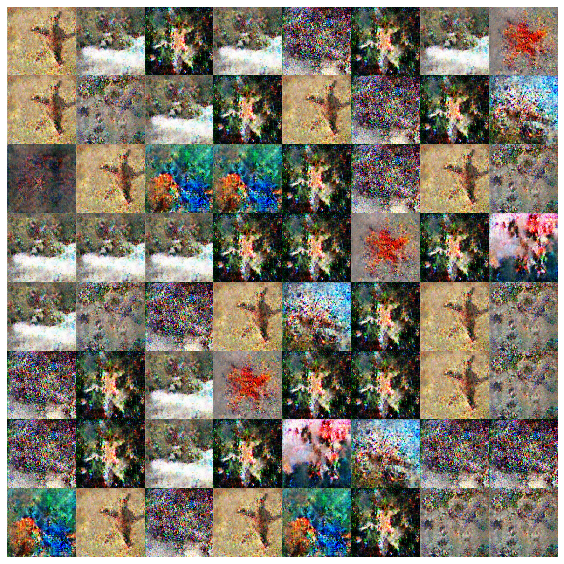

     Batch 50/184 generator loss | discriminator loss : 2.8045003 | 0.70887274 - batch took 6.238020658493042 s.
     Batch 51/184 generator loss | discriminator loss : 2.2549052 | 0.7043463 - batch took 1.622917652130127 s.
     Batch 52/184 generator loss | discriminator loss : 2.492363 | 0.7602118 - batch took 1.3365347385406494 s.
     Batch 53/184 generator loss | discriminator loss : 2.1954641 | 0.70080686 - batch took 1.341428279876709 s.
     Batch 54/184 generator loss | discriminator loss : 2.190474 | 0.6659513 - batch took 1.3329918384552002 s.
     Batch 55/184 generator loss | discriminator loss : 2.7250535 | 0.63834685 - batch took 0.3684694766998291 s.
     Batch 56/184 generator loss | discriminator loss : 1.9440272 | 0.72091436 - batch took 1.3216361999511719 s.
     Batch 57/184 generator loss | discriminator loss : 2.2758405 | 0.667737 - batch took 1.339294195175171 s.
     Batch 58/184 generator loss | discriminator loss : 2.2332034 | 0.7255086 - batch took 1.332426

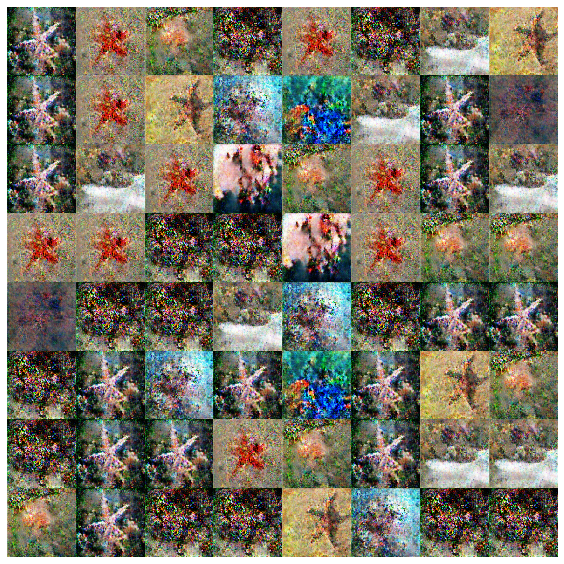

     Batch 100/184 generator loss | discriminator loss : 2.5810907 | 0.7422217 - batch took 5.645802021026611 s.
     Batch 101/184 generator loss | discriminator loss : 2.2246459 | 0.73264754 - batch took 1.6091866493225098 s.
     Batch 102/184 generator loss | discriminator loss : 2.3344107 | 0.74349463 - batch took 1.3452050685882568 s.
     Batch 103/184 generator loss | discriminator loss : 2.318406 | 0.68753576 - batch took 1.3302254676818848 s.
     Batch 104/184 generator loss | discriminator loss : 2.679864 | 0.64442784 - batch took 0.3696761131286621 s.
     Batch 105/184 generator loss | discriminator loss : 2.1810336 | 0.69180346 - batch took 1.3330612182617188 s.
     Batch 106/184 generator loss | discriminator loss : 2.256886 | 0.6589155 - batch took 1.318446397781372 s.
     Batch 107/184 generator loss | discriminator loss : 2.1539595 | 0.7042896 - batch took 1.313608169555664 s.
     Batch 108/184 generator loss | discriminator loss : 2.2441509 | 0.69756854 - batch t

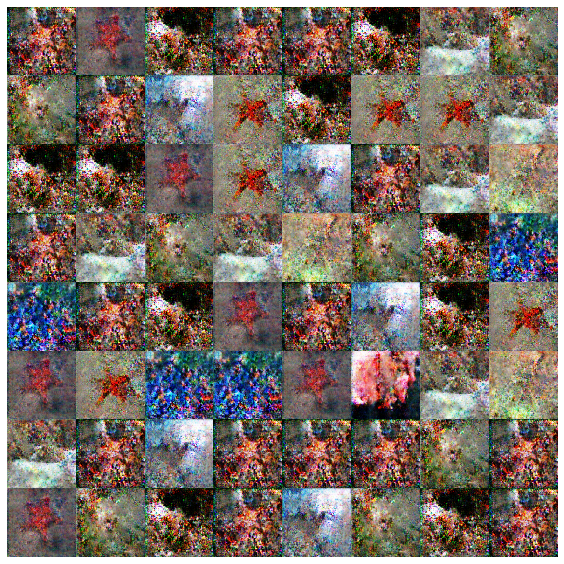

     Batch 150/184 generator loss | discriminator loss : 1.9537842 | 0.66604054 - batch took 5.962332725524902 s.
     Batch 151/184 generator loss | discriminator loss : 2.4069903 | 0.6871147 - batch took 1.6557400226593018 s.
     Batch 152/184 generator loss | discriminator loss : 2.0591192 | 0.6702913 - batch took 1.350426435470581 s.
     Batch 153/184 generator loss | discriminator loss : 2.5515628 | 0.5889767 - batch took 0.3751342296600342 s.
     Batch 154/184 generator loss | discriminator loss : 2.4593067 | 0.6604052 - batch took 1.3154077529907227 s.
     Batch 155/184 generator loss | discriminator loss : 2.213623 | 0.6628498 - batch took 1.353975772857666 s.
     Batch 156/184 generator loss | discriminator loss : 2.1921868 | 0.6819687 - batch took 1.3411729335784912 s.
     Batch 157/184 generator loss | discriminator loss : 2.344545 | 0.69045866 - batch took 1.3381214141845703 s.
     Batch 158/184 generator loss | discriminator loss : 2.19999 | 0.69938135 - batch took 

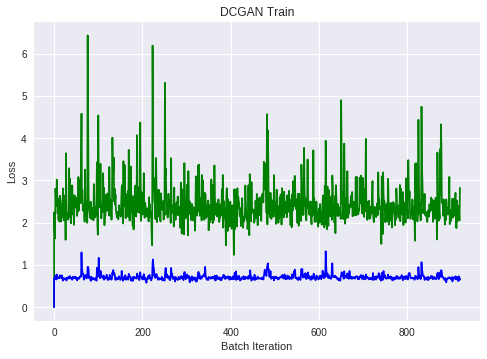

Epoch 6/60 :
     Batch 1/184 generator loss | discriminator loss : 2.1718085 | 0.7094985 - batch took 1.3566319942474365 s.
     Batch 2/184 generator loss | discriminator loss : 2.3840113 | 0.6384053 - batch took 1.34525728225708 s.
     Batch 3/184 generator loss | discriminator loss : 2.1873078 | 0.6832168 - batch took 1.333815574645996 s.
     Batch 4/184 generator loss | discriminator loss : 3.3250904 | 0.7941818 - batch took 0.37685537338256836 s.
     Batch 5/184 generator loss | discriminator loss : 2.6489134 | 0.7325934 - batch took 1.3240272998809814 s.
     Batch 6/184 generator loss | discriminator loss : 2.3194306 | 0.68952763 - batch took 1.3318705558776855 s.
     Batch 7/184 generator loss | discriminator loss : 1.935031 | 0.68100065 - batch took 1.415306568145752 s.
     Batch 8/184 generator loss | discriminator loss : 2.6771123 | 0.6691719 - batch took 1.3227694034576416 s.
     Batch 9/184 generator loss | discriminator loss : 2.0828452 | 0.6952245 - batch took 1.3

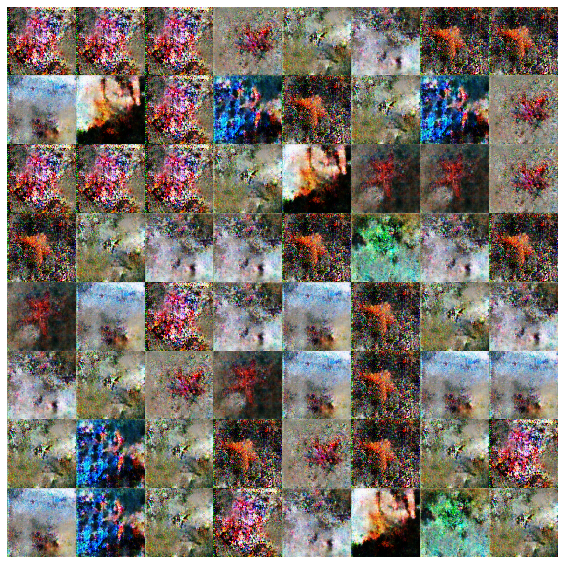

     Batch 50/184 generator loss | discriminator loss : 2.3604975 | 0.6836362 - batch took 5.971172332763672 s.
     Batch 51/184 generator loss | discriminator loss : 2.278057 | 0.6344645 - batch took 1.6340937614440918 s.
     Batch 52/184 generator loss | discriminator loss : 2.0861006 | 0.69046426 - batch took 1.3380000591278076 s.
     Batch 53/184 generator loss | discriminator loss : 2.4290442 | 0.625908 - batch took 0.3752014636993408 s.
     Batch 54/184 generator loss | discriminator loss : 2.907055 | 0.7539437 - batch took 1.3252418041229248 s.
     Batch 55/184 generator loss | discriminator loss : 2.4574206 | 0.70554453 - batch took 1.319636344909668 s.
     Batch 56/184 generator loss | discriminator loss : 2.2293992 | 0.6417973 - batch took 1.31618070602417 s.


KeyboardInterrupt: ignored

In [0]:
def main():
    dataset_path =  r'drive/My Drive/render/starfish1/photo'
    sketch_path = r'drive/My Drive/render/starfish1/sketch'
    batch_size = 64
    image_shape = (256, 256, 3)
    epochs = 60
    folder = train_dcgan(batch_size, epochs,
              image_shape, dataset_path, sketch_path, retrain=True, model_folder='2018-12-03', saved_epoch=29)
    
    test_model(r'drive/My Drive/render/GAN/test', 64, image_shape, model_name=folder, saved_epoch=59)

if __name__ == "__main__":
    main()

Reading Data-----
Found 100 images belonging to 1 classes.
Reading Model-----
Generating Images-----
Saving Images-----


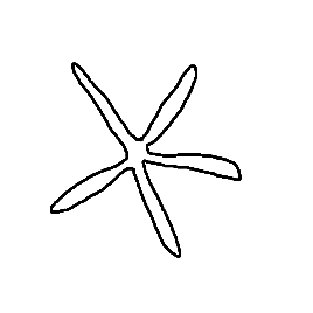

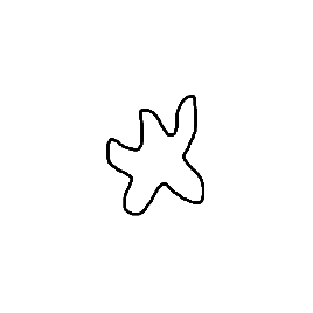

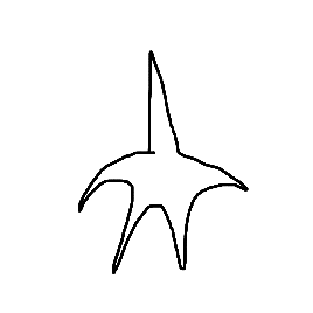

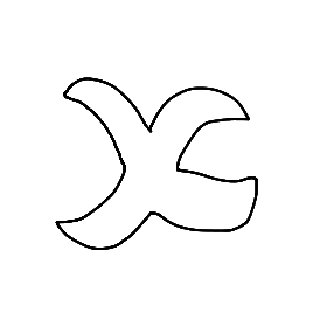

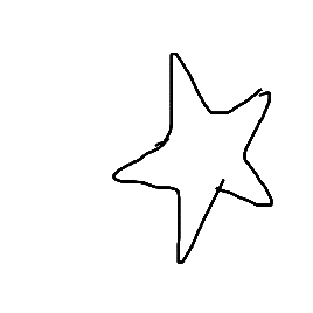

...

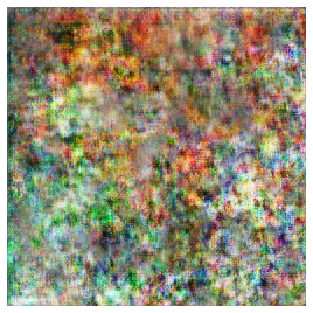

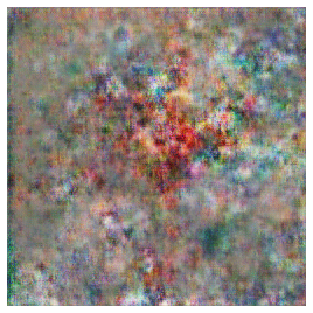

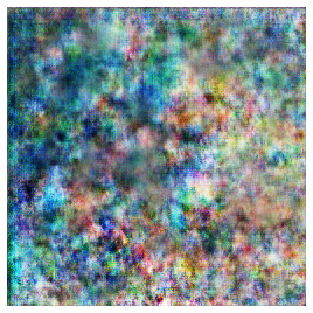

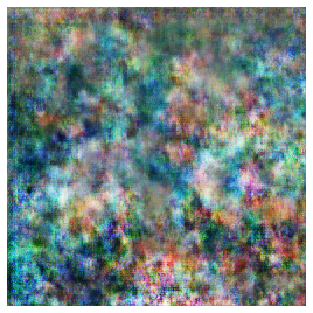

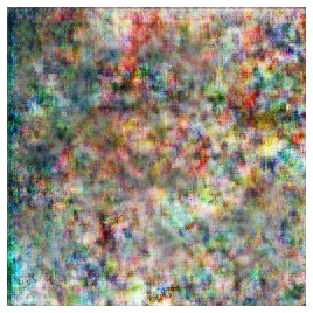

Completed


In [0]:
test_model('drive/My Drive/render/GAN/test/sketch/', 64, (256, 256, 3), model_name='2018-12-04', saved_epoch=4,file_extd_name='_epoch49_')